In [175]:
import scanpy as sc
import cv2 as cv
import matplotlib.pyplot as plt
import pandas as pd

In [1]:
# mapping result to metagenome gene list
read_contigclst_path = "/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/STARunmapped.bac.nonribosomal.90id.fastq_metagenomeGenes.bt.sam.3col"

# metagenome gene COG annotation list
contigclst_annotation_path = "/workdir/lt425/202403_miniseq_metagenome/prodigal/contigs.fasta.faa.COG.dmnd.top.annot"

# mapping reads and spatial coordinates
read_spatial_path = "/workdir/lt425/202402_stereoseq/nontotal/align_out/C02927D611/STARsolo/Kraken_barcodes.txt.gz"


location_out = '/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/function/'

# reads mapped to contigs

In [2]:
sequences = []


with open('STARunmapped.bac.nonribosomal.90id.fastq_metagenomeGenes.bt.sam.3col.read_name.txt', 'r') as f: # this can be 'gene cluster annotated reads list' for shorter memory
    for line in f:
        sequences.append(line.strip())

sequences


['E150020888L1C001R00100714444',
 'E150020888L1C001R00100716316',
 'E150020888L1C001R00100817339',
 'E150020888L1C001R00101658383',
 'E150020888L1C001R00102941183',
 'E150020888L1C001R00300015566',
 'E150020888L1C001R00300165105',
 'E150020888L1C001R00300421595',
 'E150020888L1C001R00300604744',
 'E150020888L1C001R00301397983',
 'E150020888L1C001R00301816027',
 'E150020888L1C001R00303879239',
 'E150020888L1C001R00200675852',
 'E150020888L1C001R00200857298',
 'E150020888L1C001R00200857299',
 'E150020888L1C001R00201490298',
 'E150020888L1C001R00201515497',
 'E150020888L1C001R00201636090',
 'E150020888L1C001R00201731440',
 'E150020888L1C001R00201986388',
 'E150020888L1C001R00202106931',
 'E150020888L1C001R00202289180',
 'E150020888L1C001R00203221623',
 'E150020888L1C001R00400109716',
 'E150020888L1C001R00400254542',
 'E150020888L1C001R00400450630',
 'E150020888L1C001R00400725408',
 'E150020888L1C001R00401382412',
 'E150020888L1C001R00401461437',
 'E150020888L1C001R00402642816',
 'E1500208

In [3]:
len(sequences)

22576734

In [4]:
import gzip
import ahocorasick

search_strings = sequences  # 探したい文字列のリスト
A = ahocorasick.Automaton()

# パターンを登録
for idx, key in enumerate(search_strings):
    A.add_word(key, (idx, key))

A.make_automaton()

line_num = 0
with gzip.open(read_spatial_path, "rt") as spatial_file, open('/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/Kraken_barcodes_bac.nonribosomal.genemapped.90id.txt', 'w') as outfile:
    for line_num, line in enumerate(spatial_file, start=1):
        if any(A.iter(line)):
            outfile.write(line)
        line_num += 1
        if line_num % 100000 == 0:
            print(line_num)

del A

100000
200000
300000
400000
500000
600000
700000
800000
900000
1000000
1100000
1200000
1300000
1400000
1500000
1600000
1700000
1800000
1900000
2000000
2100000
2200000
2300000
2400000
2500000
2600000
2700000
2800000
2900000
3000000
3100000
3200000
3300000
3400000
3500000
3600000
3700000
3800000
3900000
4000000
4100000
4200000
4300000
4400000
4500000
4600000
4700000
4800000
4900000
5000000
5100000
5200000
5300000
5400000
5500000
5600000
5700000
5800000
5900000
6000000
6100000
6200000
6300000
6400000
6500000
6600000
6700000
6800000
6900000
7000000
7100000
7200000
7300000
7400000
7500000
7600000
7700000
7800000
7900000
8000000
8100000
8200000
8300000
8400000
8500000
8600000
8700000
8800000
8900000
9000000
9100000
9200000
9300000
9400000
9500000
9600000
9700000
9800000
9900000
10000000
10100000
10200000
10300000
10400000
10500000
10600000
10700000
10800000
10900000
11000000
11100000
11200000
11300000
11400000
11500000
11600000
11700000
11800000
11900000
12000000
12100000
12200000
12300000
1

In [7]:
# read the cut out kraken file
read_spatial_path = "/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/Kraken_barcodes_bac.nonribosomal.genemapped.90id.txt"

# read-spatialファイルを辞書に読み込む
spatial_dict = {}
with open(read_spatial_path, "r") as spatial_file:
    line_num = 0
    for line in spatial_file:
        cols = line.strip().split("\t")
        if cols[0] == 'C':
            spatial_dict[cols[1]] = [cols[5],cols[7],cols[2]]
        line_num += 1
        if line_num % 1000000 == 0:
            print(line_num)

1000000
2000000
3000000
4000000
5000000
6000000
7000000
8000000
9000000
10000000
11000000
12000000
13000000
14000000
15000000
16000000
17000000
18000000
19000000
20000000
21000000
22000000


In [29]:
spatial_dict

{'E150020888L1C001R00100000999': ['GCTGATCCCCGTTTGACCACCCTAC',
  'CAAGAGGTTT',
  'Parabacteroides (taxid 375288)'],
 'E150020888L1C001R00100001113': ['GGGTATAGCTACGAGTTCTGGATAC',
  'CAAGAGGTTT',
  'Duncaniella (taxid 2518495)'],
 'E150020888L1C001R00100001211': ['TGCTAATCGCCCGAGAGGTTTGTCC',
  'CGGGGCCGTA',
  'unclassified Duncaniella (taxid 2649562)'],
 'E150020888L1C001R00100001395': ['GGACCGATGAGTGTTTTATCAGTTT',
  'TAGCGCCCCT',
  'unclassified Duncaniella (taxid 2649562)'],
 'E150020888L1C001R00100001602': ['TCTAGAAGCACTTAGGGTAACGGCT',
  'TAATCGACCC',
  'Duncaniella (taxid 2518495)'],
 'E150020888L1C001R00100001800': ['TAGCCATGTCACAGTAACCCCTAGA',
  'ACGGTGGCAT',
  'Duncaniella (taxid 2518495)'],
 'E150020888L1C001R00100002097': ['ACCGTCCCTCCTAGGGCTGAGTCAC',
  'CACATCCTAG',
  'unclassified Duncaniella (taxid 2649562)'],
 'E150020888L1C001R00100002378': ['CTGTACTCCTTTCCTATACGTTCCC',
  'CCCCCGTCAA',
  'Firmicutes (taxid 1239)'],
 'E150020888L1C001R00100002383': ['CCATCCACGGTAGCATTATTCAC

In [8]:
len(spatial_dict)

22576734

In [33]:
read_contigclst_path


'/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/STARunmapped.bac.nonribosomal.90id.fastq_metagenomeGenes.bt.sam.3col'

In [16]:
spatial_dict

{'E150020888L1C001R00100714444': ['ATCCACCAACGTCCTCCTGCAGATA',
  'AATCGACTTG',
  'Bacteroidales (taxid 171549)'],
 'E150020888L1C001R00100716316': ['GGCCATACCCCCACATCCGTTATGC',
  'CAGTCGAAAG',
  'Duncaniella (taxid 2518495)'],
 'E150020888L1C001R00100817339': ['TCGTAGTCGGTGAGGCCTATTGCCC',
  'CTAGCTTCCC',
  'Acidovorax sp. 1608163 (taxid 2478662)'],
 'E150020888L1C001R00101658383': ['GGCCAAACGTTCGATGTCTCTTGGC',
  'CCCTCACTGC',
  'Muribaculaceae (taxid 2005473)'],
 'E150020888L1C001R00102941183': ['TCGTCGTTAGCGGGTCTCAACGCGT',
  'TTCCGGGATC',
  'Bacteroidales (taxid 171549)'],
 'E150020888L1C001R00300015566': ['GCATTGTCGAATGCCAAGACAGGAA',
  'ACCTTAAGCC',
  'Bacteria (taxid 2)'],
 'E150020888L1C001R00300165105': ['GGTATCCTCTGTGATAGTGTAGGGG',
  'GTGCCGTACG',
  'Duncaniella (taxid 2518495)'],
 'E150020888L1C001R00300421595': ['GTCAGCGAGACCTCGGAGCCCATGG',
  'GACTTCCGCG',
  'Acidovorax sp. 1608163 (taxid 2478662)'],
 'E150020888L1C001R00300604744': ['CATTGGATGTAATTTTTCAGCTCTA',
  'ATTCTGGATG',

In [17]:
len(spatial_dict)

22576734

In [20]:
read_contigclst_path

'/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/STARunmapped.bac.nonribosomal.90id.fastq_metagenomeGenes.bt.sam.3col'

In [ ]:
# annotation

In [10]:

# contigclst -> COG annotation dict
annotation_dict = {}
with open(contigclst_annotation_path, "r") as annotation_file:
    for line in annotation_file:
        cols = line.strip().split("\t")
        if len(cols) >= 2:
            annotation_dict[cols[0]] = cols[1:]


In [11]:
annotation_dict

{'NODE_1_length_97008_cov_9.289862_18': ['WP_015195718.1',
  'COG0210',
  'GCF_000317575.1',
  'L',
  'Superfamily I DNA or RNA helicase',
  'UvrD',
  'nan',
  'nan',
  '6PPR'],
 'NODE_1_length_97008_cov_9.289862_86': ['WP_079240493.1',
  'COG4186',
  'GCF_002025665.1',
  'R',
  'Uncharacterized conserved protein MJ1445, calcineurin-like phosphoesterase superfamily',
  'nan',
  'nan',
  'nan',
  '1XM7'],
 'NODE_1_length_97008_cov_9.289862_92': ['WP_010053887.1',
  'COG0317',
  'GCF_000317975.2',
  'TK',
  '(p)ppGpp synthase/hydrolase, HD superfamily',
  'SpoT',
  'nan',
  'nan',
  '1TDJ'],
 'NODE_1_length_97008_cov_9.289862_99': ['WP_011770973.1',
  'COG0645',
  'GCF_000015285.1',
  'R',
  'Predicted kinase, contains AAA domain',
  'nan',
  'nan',
  'nan',
  '2RHM'],
 'NODE_1_length_97008_cov_9.289862_105': ['WP_013685335.1',
  'COG3541',
  'GCF_000194605.1',
  'R',
  'Predicted nucleotidyltransferase YcgL',
  'YcgL',
  'nan',
  'nan',
  'nan'],
 'NODE_1_length_97008_cov_9.289862_137':

In [12]:
len(annotation_dict)

56151

In [26]:
umi_function = {}
# read-contigclstファイルを読み込み、条件に従って出力ファイルに書き込む
with open(read_contigclst_path, "r") as read_contigclst_file, open(output_path, "w") as output_file:
    line_num = 0
    for line in read_contigclst_file:
        cols = line.strip().split("\t")
        if len(cols) >= 1 and cols[0] in spatial_dict.keys():
            read_id = cols[0]
            gene = cols[1]
            sp_bcd, umi, tax = spatial_dict[read_id]
            uniq_bcd = sp_bcd + umi
            if uniq_bcd not in umi_function.keys():
                if gene in annotation_dict.keys():
                    func_list = annotation_dict[gene]
                    umi_function[uniq_bcd] = [func_list + [tax] + [sp_bcd]]
                else:
                    umi_function[uniq_bcd] = [[gene, gene, tax, sp_bcd]]
            else:
                if gene in annotation_dict.keys():
                    func_list = annotation_dict[gene]
                    umi_function[uniq_bcd].append(func_list + [tax] + [sp_bcd])
                else:
                    umi_function[uniq_bcd].append([gene, gene, tax, sp_bcd])
        else:
            print(line)
        line_num += 1
        if line_num % 1000000 == 0:
            print(line_num)


1000000
2000000
3000000
4000000
5000000
6000000
7000000
8000000
9000000
10000000
11000000
12000000
13000000
14000000
15000000
16000000
17000000
18000000
19000000
20000000
21000000
22000000


In [27]:
umi_function

{'ATCCACCAACGTCCTCCTGCAGATAAATCGACTTG': [['NODE_726_length_3161_cov_17.794591_2',
   'NODE_726_length_3161_cov_17.794591_2',
   'Bacteroidales (taxid 171549)',
   'ATCCACCAACGTCCTCCTGCAGATA'],
  ['NODE_726_length_3161_cov_17.794591_2',
   'NODE_726_length_3161_cov_17.794591_2',
   'Bacteroidales (taxid 171549)',
   'ATCCACCAACGTCCTCCTGCAGATA'],
  ['NODE_726_length_3161_cov_17.794591_2',
   'NODE_726_length_3161_cov_17.794591_2',
   'Bacteroidales (taxid 171549)',
   'ATCCACCAACGTCCTCCTGCAGATA'],
  ['NODE_726_length_3161_cov_17.794591_2',
   'NODE_726_length_3161_cov_17.794591_2',
   'Bacteroidales (taxid 171549)',
   'ATCCACCAACGTCCTCCTGCAGATA'],
  ['NODE_726_length_3161_cov_17.794591_2',
   'NODE_726_length_3161_cov_17.794591_2',
   'Bacteroidales (taxid 171549)',
   'ATCCACCAACGTCCTCCTGCAGATA'],
  ['NODE_726_length_3161_cov_17.794591_2',
   'NODE_726_length_3161_cov_17.794591_2',
   'Bacteroidales (taxid 171549)',
   'ATCCACCAACGTCCTCCTGCAGATA'],
  ['NODE_726_length_3161_cov_17.79459

In [14]:
umi_function

{'CTAGCTTCCC': ['WP_058900184.1',
  'COG0050',
  'GCF_001484065.1',
  'J',
  'Translation elongation factor EF-Tu, a GTPase',
  'TufA',
  'Translation factors',
  'nan',
  '1EFU',
  'Acidovorax sp. 1608163 (taxid 2478662)',
  'TCGTAGTCGGTGAGGCCTATTGCCC'],
 'GACTTCCGCG': ['WP_058900184.1',
  'COG0050',
  'GCF_001484065.1',
  'J',
  'Translation elongation factor EF-Tu, a GTPase',
  'TufA',
  'Translation factors',
  'nan',
  '1EFU',
  'Acidovorax sp. 1608163 (taxid 2478662)',
  'GTCAGCGAGACCTCGGAGCCCATGG'],
 '-': ['WP_058900184.1',
  'COG0050',
  'GCF_001484065.1',
  'J',
  'Translation elongation factor EF-Tu, a GTPase',
  'TufA',
  'Translation factors',
  'nan',
  '1EFU',
  'Acidovorax sp. 1608163 (taxid 2478662)',
  '-'],
 'CGCATATCCG': ['WP_058900184.1',
  'COG0050',
  'GCF_001484065.1',
  'J',
  'Translation elongation factor EF-Tu, a GTPase',
  'TufA',
  'Translation factors',
  'nan',
  '1EFU',
  'Bacteroidota (taxid 976)',
  'CGATTCGAAAAAATACAAGCGACCC'],
 'CATAGGGATT': ['WP_058

In [28]:
len(umi_function)

967392

In [31]:
# umi_functionを基にして、新しい辞書を作成する
sp_gene_dict = {}

for uniq_bcd, values in umi_function.items():
    for value in values:
        sp_bcd = value[-1]
        if sp_bcd not in sp_gene_dict:
            sp_gene_dict[sp_bcd] = [value[0]]
        else:
            sp_gene_dict[sp_bcd].append(value[0])

# 結果を出力する
sp_gene_dict

{'ATCCACCAACGTCCTCCTGCAGATA': ['NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_1',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_2',
  'NODE_726_length_3161_cov_17.794591_1',
  'NO

In [42]:
import numpy as np
import scipy.sparse as sp

d = sp_gene_dict
unique_values = set()
for lst in d.values():
    unique_values.update(lst)
    
key_to_int = {key: idx for idx, key in enumerate(d.keys())}

# unique_valuesを連続した整数値に変換するためのマッピングを作成する
value_to_int = {value: idx for idx, value in enumerate(unique_values)}

# 変換後のスパース行列のサイズを計算する
n_rows = len(key_to_int)
n_cols = len(value_to_int)


taxlist = value_to_int.keys()
with open(location_out + 'genelist.txt', 'w') as f:
    for item in taxlist:
        f.write("%s\n" % item)
del taxlist

spatlist = key_to_int.keys()
with open(location_out + 'spatial_bcd.txt', 'w') as f:
    for item in spatlist:
        #if(item != '-'):
        f.write("%s\n" % item)
del spatlist



In [37]:
from scipy.io import mmwrite

# スパース行列を作成する
mat = sp.dok_matrix((n_rows, n_cols), dtype=np.int64)

# マッピングを使用してdを変換し、スパース行列に値を設定する
for key, values in d.items():
    row_idx = key_to_int[key]
    for value in values:
        col_idx = value_to_int[value]
        mat[row_idx, col_idx] = mat[row_idx, col_idx]+1

# スパース行列を圧縮する
mat = mat.tocsr()

#sp.save_npz(location_out + 'kraken_output_mat.npz', mat)

# 行列を .mtx ファイルとして保存
mmwrite(location_out + 'function_mat.mtx', mat)

In [ ]:
# mat to ad

In [50]:
## anndata
import pandas as pd
import scanpy as sc
import anndata
# Matrixを読み込む
barcodes = pd.read_csv(location_out + 'spatial_bcd.txt', header=None, names=['barcodes'])#,compression='gzip')
barcodes.index = barcodes['barcodes']
features = pd.read_csv(location_out + 'genelist.txt', header=None, names=['features'])#,compression='gzip')
features.index = features['features']
matrix = sc.read_mtx(location_out + 'function_mat.mtx')

# AnnDataオブジェクトを作成
adata_func = anndata.AnnData(X=matrix.X, obs=barcodes, var=features)

adata_func

AnnData object with n_obs × n_vars = 762521 × 143
    obs: 'barcodes'
    var: 'features'

In [63]:
adata_func.obs['total_counts'] = adata_func.X.sum(axis=1)
adata_func.obs['total_counts']

barcodes
ATCCACCAACGTCCTCCTGCAGATA    164.0
GGCCATACCCCCACATCCGTTATGC      4.0
TCGTAGTCGGTGAGGCCTATTGCCC    312.0
GGCCAAACGTTCGATGTCTCTTGGC     48.0
TCGTCGTTAGCGGGTCTCAACGCGT    136.0
                             ...  
TGCAGCCTGGTCACCCGTGCAGTGC      1.0
ACCCGTCAAAGATGTCTGATGGACC      1.0
GGGTAAGCGAACCAGAGGTATCACT      1.0
CTGTCAGGCCGGCAGTCTCCCGTTT      1.0
GTGTTGGATCGGCACCTTGAATCCT      1.0
Name: total_counts, Length: 762521, dtype: float32

In [54]:
adata_func.X.sum(axis=0).A1

array([1.7000000e+02, 4.0000000e+00, 2.7700000e+02, 3.0000000e+00,
       2.0000000e+00, 2.8240000e+03, 6.5000000e+02, 1.0000000e+00,
       1.8000000e+01, 6.5734000e+04, 1.0000000e+00, 1.6685000e+04,
       5.5400000e+02, 5.0030000e+04, 2.2000000e+01, 1.0902300e+05,
       1.4992110e+06, 5.0000000e+00, 8.0000000e+00, 5.0000000e+00,
       2.0000000e+00, 7.0000000e+00, 2.0000000e+00, 1.2000000e+01,
       5.1000000e+01, 3.3000000e+01, 2.6000000e+01, 4.0000000e+01,
       1.1356000e+04, 1.9740000e+03, 1.0000000e+00, 4.0000000e+00,
       2.9000000e+01, 1.0000000e+00, 3.4000000e+01, 6.0990000e+03,
       1.0600000e+02, 5.5390000e+03, 1.2000000e+01, 2.5600000e+03,
       5.8010000e+03, 3.0000000e+00, 1.2700000e+02, 4.0000000e+00,
       1.1700000e+02, 1.2500000e+02, 1.0000000e+00, 2.0100000e+02,
       1.0000000e+01, 1.1020000e+03, 2.4800000e+02, 2.4000000e+01,
       8.0000000e+00, 2.4438000e+04, 2.0000000e+00, 3.0000000e+00,
       3.0000000e+00, 1.6000000e+01, 4.7000000e+01, 2.0000000e

In [94]:
adata_func.var['total'] = adata_func.X.sum(axis=0).A1
adata_func.var['total']

features
NODE_10815_length_819_cov_4.040576_1        170.0
WP_010998475.1                                4.0
NODE_304216_length_165_cov_7.227273_1       277.0
NODE_299838_length_203_cov_3.378378_1         3.0
NODE_300970_length_192_cov_2.204380_1         2.0
                                           ...   
NODE_315307_length_115_cov_4.266667_1     12781.0
NODE_260184_length_215_cov_1.737500_1         2.0
NODE_319891_length_107_cov_46.134615_1      230.0
NODE_15259_length_697_cov_2.789720_1         19.0
NODE_329010_length_96_cov_1.878049_1       9932.0
Name: total, Length: 143, dtype: float32

In [56]:
adata_func.write(location_out + 'adata_func.h5ad')

In [59]:
bc_map="/workdir/Data/lt425_SPATIAL/202402_stereoseq/mask/C02927D611.barcodeToPos.h5.txt" #/fs/cbsuvlaminck2
bc_map_df = pd.read_csv(bc_map,sep='\t',index_col=0, header=None)
bc_map_df=bc_map_df.reindex(adata_func.obs.index)
bc_map_df.columns = ["X","Y"]

#### Adding spatial information
adata_func.obsm['spatial'] = bc_map_df[['X', 'Y']].values

adata_func.uns['spatial'] = {'coordinates':  adata_func.obsm['spatial']}
adata_func.uns['spatial']

{'coordinates': array([[7426., 3904.],
        [4847., 5432.],
        [6015., 3795.],
        ...,
        [5896., 3625.],
        [1120., 3677.],
        [6534., 4231.]])}

In [64]:
adata_func

AnnData object with n_obs × n_vars = 762521 × 143
    obs: 'barcodes', 'total_counts'
    var: 'features', 'total'
    uns: 'spatial'
    obsm: 'spatial'

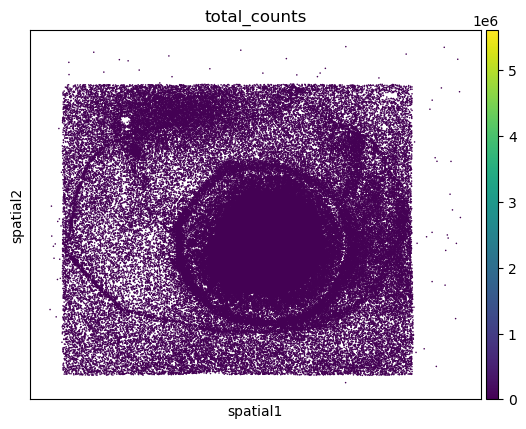

In [65]:
from matplotlib.colors import ListedColormap

sc.pl.embedding(
    adata_func, 
    basis="spatial", 
    use_raw = False,
    color=['total_counts'],
    cmap='viridis',
    show=True,
    na_color= 'grey',
    vmin = 0,
#    vmax = 50,
    size = 5
)


In [66]:
adata_func.write(location_out + 'adata_func.h5ad')

In [83]:
adata_func = sc.read(location_out + 'adata_func.h5ad')
adata_func

AnnData object with n_obs × n_vars = 762521 × 143
    obs: 'barcodes', 'total_counts'
    var: 'features', 'total'
    uns: 'spatial'
    obsm: 'spatial'

In [85]:
# gene - annotation
# umi_functionを基にして、新しい辞書を作成する
gene_annot_dict = {}

for uniq_bcd, values in umi_function.items():
    for value in values:
        gene = value[0]
        if sp_bcd not in gene_annot_dict:
            gene_annot_dict[gene] = [value[:-1]]
        else:
            gene_annot_dict[sp_bcd].append(value[:-1])

# 結果を出力する
gene_annot_dict

{'NODE_726_length_3161_cov_17.794591_2': [['NODE_726_length_3161_cov_17.794591_2',
   'NODE_726_length_3161_cov_17.794591_2',
   'Duncaniella (taxid 2518495)']],
 'NODE_726_length_3161_cov_17.794591_1': [['NODE_726_length_3161_cov_17.794591_1',
   'NODE_726_length_3161_cov_17.794591_1',
   'Muribaculaceae (taxid 2005473)']],
 'NODE_233737_length_223_cov_2.732143_1': [['NODE_233737_length_223_cov_2.732143_1',
   'NODE_233737_length_223_cov_2.732143_1',
   'Duncaniella (taxid 2518495)']],
 'WP_058900184.1': [['WP_058900184.1',
   'COG0050',
   'GCF_001484065.1',
   'J',
   'Translation elongation factor EF-Tu, a GTPase',
   'TufA',
   'Translation factors',
   'nan',
   '1EFU',
   'Bacteroidota (taxid 976)']],
 'NODE_13784_length_732_cov_20.194978_1': [['NODE_13784_length_732_cov_20.194978_1',
   'NODE_13784_length_732_cov_20.194978_1',
   'Parabacteroides (taxid 375288)']],
 'NODE_15135_length_700_cov_4.066667_1': [['NODE_15135_length_700_cov_4.066667_1',
   'NODE_15135_length_700_cov_4

In [88]:
import numpy as np
import pandas as pd

# Initialize an empty DataFrame with appropriate columns
columns = ["cog", "gen", "cat1", "cat2", "gen2", "cat3", "bac"]
var_mat = pd.DataFrame(index=adata_func.var.index, columns=columns)

def extract_annotations(gene_id):
    annot = gene_annot_dict[gene_id][0]
    if len(annot) > 3:
        cog = annot[1]
        gen = annot[2]
        cat1 = annot[3]
        cat2 = annot[4]
        gen2 = annot[5]
        cat3 = annot[6]
        bac = annot[-1]
    else:
        cog = np.nan
        gen = np.nan
        cat1 = np.nan
        cat2 = np.nan
        gen2 = np.nan
        cat3 = np.nan
        bac = np.nan
    return pd.Series([cog, gen, cat1, cat2, gen2, cat3, bac], index=columns)

# Apply the extraction function to each gene in var.index
var_mat = adata_func.var.index.to_series().apply(extract_annotations)

print(var_mat)


                                            cog              gen cat1  \
features                                                                
NODE_10815_length_819_cov_4.040576_1        NaN              NaN  NaN   
WP_010998475.1                          COG0050  GCF_000009705.1    J   
NODE_304216_length_165_cov_7.227273_1       NaN              NaN  NaN   
NODE_299838_length_203_cov_3.378378_1       NaN              NaN  NaN   
NODE_300970_length_192_cov_2.204380_1       NaN              NaN  NaN   
...                                         ...              ...  ...   
NODE_315307_length_115_cov_4.266667_1       NaN              NaN  NaN   
NODE_260184_length_215_cov_1.737500_1       NaN              NaN  NaN   
NODE_319891_length_107_cov_46.134615_1      NaN              NaN  NaN   
NODE_15259_length_697_cov_2.789720_1        NaN              NaN  NaN   
NODE_329010_length_96_cov_1.878049_1        NaN              NaN  NaN   

                                                  

In [89]:
adata_func.var = var_mat

In [96]:
adata_func.write(location_out + 'adata_func2.h5ad')

In [98]:
adata_func.var['total'].sort_values(ascending=False)[:20]

features
NODE_13784_length_732_cov_20.194978_1     14040712.0
NODE_15135_length_700_cov_4.066667_1       2721067.0
NODE_726_length_3161_cov_17.794591_2       1579752.0
NODE_726_length_3161_cov_17.794591_1       1499211.0
NODE_233737_length_223_cov_2.732143_1      1307315.0
NODE_314341_length_118_cov_2.269841_1       470739.0
NODE_5400_length_1131_cov_2.729554_1        291966.0
NODE_106078_length_299_cov_1.795082_1       143036.0
NODE_10983_length_812_cov_3.319683_1        109023.0
NODE_27452_length_532_cov_14.939203_1        94463.0
NODE_321359_length_105_cov_7.380000_1        65734.0
NODE_311662_length_126_cov_5.225352_1        50030.0
NODE_291002_length_207_cov_3.000000_1        34473.0
WP_058900184.1                               24438.0
NODE_165887_length_252_cov_10.989848_1       16685.0
NODE_315307_length_115_cov_4.266667_1        12781.0
NODE_260232_length_215_cov_1.650000_1        12654.0
NODE_310376_length_131_cov_7.565789_1        11356.0
NODE_329010_length_96_cov_1.878049_1 

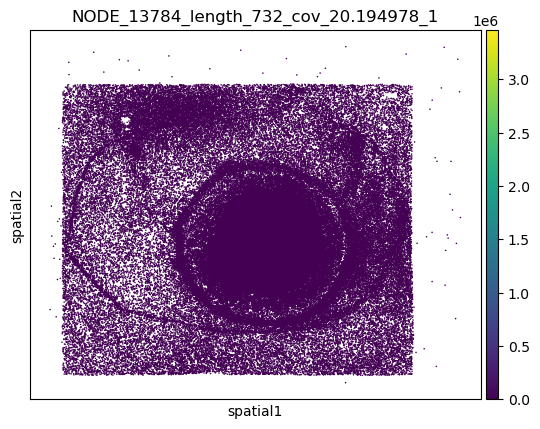

In [99]:
from matplotlib.colors import ListedColormap

sc.pl.embedding(
    adata_func, 
    basis="spatial", 
    use_raw = False,
    color=['NODE_13784_length_732_cov_20.194978_1'],
    cmap='viridis',
    show=True,
    na_color= 'grey',
    vmin = 0,
#    vmax = 50,
    size = 5
)


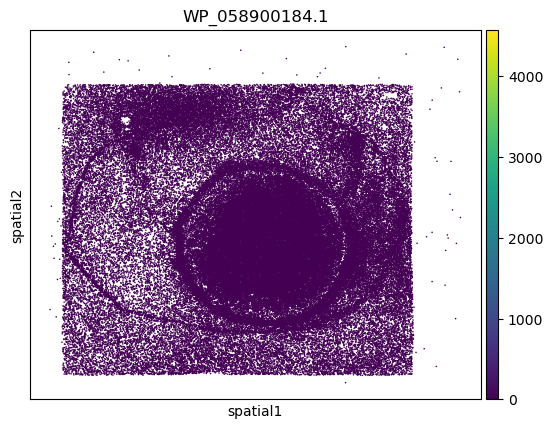

In [100]:
from matplotlib.colors import ListedColormap

sc.pl.embedding(
    adata_func, 
    basis="spatial", 
    use_raw = False,
    color=['WP_058900184.1'],
    cmap='viridis',
    show=True,
    na_color= 'grey',
    vmin = 0,
#    vmax = 50,
    size = 5
)


In [130]:
np.where(np.isnan(adata_func.obsm['spatial'].T[0]))[0]

array([9])

In [136]:
c[:10]

,barcodes,total_counts
barcodes,,
ATCCACCAACGTCCTCCTGCAGATA,ATCCACCAACGTCCTCCTGCAGATA,164.0
GGCCATACCCCCACATCCGTTATGC,GGCCATACCCCCACATCCGTTATGC,4.0
TCGTAGTCGGTGAGGCCTATTGCCC,TCGTAGTCGGTGAGGCCTATTGCCC,312.0
GGCCAAACGTTCGATGTCTCTTGGC,GGCCAAACGTTCGATGTCTCTTGGC,48.0
TCGTCGTTAGCGGGTCTCAACGCGT,TCGTCGTTAGCGGGTCTCAACGCGT,136.0
GCATTGTCGAATGCCAAGACAGGAA,GCATTGTCGAATGCCAAGACAGGAA,355.0
GGTATCCTCTGTGATAGTGTAGGGG,GGTATCCTCTGTGATAGTGTAGGGG,27.0
GTCAGCGAGACCTCGGAGCCCATGG,GTCAGCGAGACCTCGGAGCCCATGG,359.0
CATTGGATGTAATTTTTCAGCTCTA,CATTGGATGTAATTTTTCAGCTCTA,75.0


In [132]:
adata_func.obsm['spatial'].T[1][:10]

array([3904., 5432., 3795., 7113., 4813., 4546., 5967., 6504., 4223.,
         nan])

In [146]:
adata_func = adata_func[np.arange(adata_func.n_obs) != 9, :]
adata_func

View of AnnData object with n_obs × n_vars = 762520 × 143
    obs: 'barcodes', 'total_counts'
    var: 'cog', 'gen', 'cat1', 'cat2', 'gen2', 'cat3', 'bac', 'total'
    uns: 'spatial'
    obsm: 'spatial'

In [147]:
adata_func.write(location_out + 'adata_func2.h5ad')

# contour

In [166]:

contour = []

file_path = '/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/host-microbe-integrated/reshaped_contour.txt'

with open(file_path, 'r') as file:
    for line in file:
        parts = line.strip().split(' ')
        if len(parts) >= 2:
            x = int(float(parts[0]))
            y = int(float(parts[1]))
            contour.append(np.array([x, y]))
contour = np.array(contour)
print(contour)

[[6712 3067]
 [6711 3068]
 [6709 3068]
 ...
 [6715 3067]
 [6714 3068]
 [6713 3067]]


In [169]:
np.max(adata_func.obsm['spatial'].T[0])

array(11759.)

In [233]:
xmin = np.min(contour.T[0])
xmax = np.max(contour.T[0])
ymin = np.min(contour.T[1])
ymax = np.max(contour.T[1])

# 全ての整数点をリストアップ
points = [(x, y) for x in range(xmin, xmax + 1) for y in range(ymin, ymax + 1)]

# 結果を表示
points

[(4330, 3067),
 (4330, 3068),
 (4330, 3069),
 (4330, 3070),
 (4330, 3071),
 (4330, 3072),
 (4330, 3073),
 (4330, 3074),
 (4330, 3075),
 (4330, 3076),
 (4330, 3077),
 (4330, 3078),
 (4330, 3079),
 (4330, 3080),
 (4330, 3081),
 (4330, 3082),
 (4330, 3083),
 (4330, 3084),
 (4330, 3085),
 (4330, 3086),
 (4330, 3087),
 (4330, 3088),
 (4330, 3089),
 (4330, 3090),
 (4330, 3091),
 (4330, 3092),
 (4330, 3093),
 (4330, 3094),
 (4330, 3095),
 (4330, 3096),
 (4330, 3097),
 (4330, 3098),
 (4330, 3099),
 (4330, 3100),
 (4330, 3101),
 (4330, 3102),
 (4330, 3103),
 (4330, 3104),
 (4330, 3105),
 (4330, 3106),
 (4330, 3107),
 (4330, 3108),
 (4330, 3109),
 (4330, 3110),
 (4330, 3111),
 (4330, 3112),
 (4330, 3113),
 (4330, 3114),
 (4330, 3115),
 (4330, 3116),
 (4330, 3117),
 (4330, 3118),
 (4330, 3119),
 (4330, 3120),
 (4330, 3121),
 (4330, 3122),
 (4330, 3123),
 (4330, 3124),
 (4330, 3125),
 (4330, 3126),
 (4330, 3127),
 (4330, 3128),
 (4330, 3129),
 (4330, 3130),
 (4330, 3131),
 (4330, 3132),
 (4330, 31

In [237]:
contour - [6000,3000]

array([[712,  67],
       [711,  68],
       [709,  68],
       ...,
       [715,  67],
       [714,  68],
       [713,  67]])

In [277]:
xmin = np.min(contour.T[0])
xmax = np.max(contour.T[0])
ymin = np.min(contour.T[1])
ymax = np.max(contour.T[1])

def is_point_inside_contour(point, contour):
    """
    点が輪郭の内側にあるかどうかをチェックする関数
    """
    x, y = point
    return cv.pointPolygonTest(contour, (x, y), False) > 0

def get_points_inside_contour(contour, image_shape):
    """
    輪郭に囲まれた領域の内部にある座標をリストアップする関数
    """
    points_inside = []
    for y in range(image_shape[0]):
        for x in range(image_shape[1]):
            if is_point_inside_contour((x, y), contour):
                points_inside.append((x, y))
    return points_inside

#import cv2 as cv
#img = '/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/host-microbe-integrated/adata_unmap_total_3up_img.jpg' #輪郭を抽出したい画像ファイル名
#img_color = cv.imread(img) #cv2.imread(img)#画像を読み出しオブジェクトimg_colorに代入

#threshold = 50 #二値化に用いる閾値

#img_gray = cv.imread(img,cv.IMREAD_GRAYSCALE) # cv.imread(img,cv2.IMREAD_GRAYSCALE) #画像をグレースケールで読み出しオブジェクトimg_grayに代入


# 輪郭に含まれる座標をリストアップ
points_inside = get_points_inside_contour(contour - [xmin,ymin], (xmax-xmin, ymax-ymin))

# 結果を表示
#points_inside_contour
points_inside 

[(2382, 1),
 (2383, 1),
 (2385, 1),
 (2386, 1),
 (2387, 1),
 (2388, 1),
 (2389, 1),
 (2390, 1),
 (2391, 1),
 (2392, 1),
 (2393, 1),
 (2394, 1),
 (2395, 1),
 (2396, 1),
 (2397, 1),
 (2398, 1),
 (2399, 1),
 (2400, 1),
 (2401, 1),
 (2402, 1),
 (2403, 1),
 (2404, 1),
 (2405, 1),
 (2406, 1),
 (2407, 1),
 (2408, 1),
 (2409, 1),
 (2410, 1),
 (2411, 1),
 (2412, 1),
 (2413, 1),
 (2414, 1),
 (2415, 1),
 (2416, 1),
 (2425, 1),
 (2426, 1),
 (2427, 1),
 (2428, 1),
 (2429, 1),
 (2430, 1),
 (2431, 1),
 (2432, 1),
 (2433, 1),
 (2434, 1),
 (2435, 1),
 (2379, 2),
 (2380, 2),
 (2381, 2),
 (2382, 2),
 (2383, 2),
 (2384, 2),
 (2385, 2),
 (2386, 2),
 (2387, 2),
 (2388, 2),
 (2389, 2),
 (2390, 2),
 (2391, 2),
 (2392, 2),
 (2393, 2),
 (2394, 2),
 (2395, 2),
 (2396, 2),
 (2397, 2),
 (2398, 2),
 (2399, 2),
 (2400, 2),
 (2401, 2),
 (2402, 2),
 (2403, 2),
 (2404, 2),
 (2405, 2),
 (2406, 2),
 (2407, 2),
 (2408, 2),
 (2409, 2),
 (2410, 2),
 (2411, 2),
 (2412, 2),
 (2413, 2),
 (2414, 2),
 (2415, 2),
 (2416, 2),
 (24

In [284]:
points_inside_2d = [list(tup) for tup in points_inside]
points_inside_2d = np.array(points_inside_2d) + [xmin,ymin]
points_inside_2d

array([[6712, 3068],
       [6713, 3068],
       [6715, 3068],
       ...,
       [7010, 6661],
       [7011, 6661],
       [7012, 6661]])

In [285]:
np.savetxt('/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/host-microbe-integrated/spatial_inside.txt',points_inside_2d, delimiter=',')

In [170]:
# mask -> adata , transpose!?
positions = adata_func.obsm['spatial'].astype(int)

adata_func.obs['mask_tissue'] = [(tuple(i) in points_inside_contour) for i in positions]
adata_func.obs['mask_tissue'].sum()

/tmp/ipykernel_3616185/542019993.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_func.obs['mask_tissue'] = [(tuple(i) in points_inside_contour) for i in positions]


660202

In [172]:
adata_func.var['total'] = adata_func.X.sum(axis=0).A1
adata_func.var['total'].sort_values(ascending=False)[:20]

features
NODE_13784_length_732_cov_20.194978_1     10578674.0
NODE_15135_length_700_cov_4.066667_1       2065015.0
NODE_726_length_3161_cov_17.794591_2       1201406.0
NODE_726_length_3161_cov_17.794591_1       1099462.0
NODE_233737_length_223_cov_2.732143_1       930531.0
NODE_314341_length_118_cov_2.269841_1       363372.0
NODE_5400_length_1131_cov_2.729554_1        233052.0
NODE_106078_length_299_cov_1.795082_1       111869.0
NODE_10983_length_812_cov_3.319683_1         77721.0
NODE_27452_length_532_cov_14.939203_1        67286.0
NODE_321359_length_105_cov_7.380000_1        49854.0
NODE_311662_length_126_cov_5.225352_1        35198.0
NODE_291002_length_207_cov_3.000000_1        25963.0
WP_058900184.1                               19865.0
NODE_165887_length_252_cov_10.989848_1       11669.0
NODE_315307_length_115_cov_4.266667_1        10196.0
NODE_260232_length_215_cov_1.650000_1         9445.0
NODE_310376_length_131_cov_7.565789_1         8008.0
NODE_329010_length_96_cov_1.878049_1 

In [173]:
adata_func.write(location_out + 'adata_func2.h5ad')

In [171]:
location_out

'/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/function/'

In [181]:
adata_func.obs['mask_tissue']

barcodes
ATCCACCAACGTCCTCCTGCAGATA     True
GGCCATACCCCCACATCCGTTATGC     True
TCGTAGTCGGTGAGGCCTATTGCCC     True
GGCCAAACGTTCGATGTCTCTTGGC    False
TCGTCGTTAGCGGGTCTCAACGCGT     True
                             ...  
TGCAGCCTGGTCACCCGTGCAGTGC    False
ACCCGTCAAAGATGTCTGATGGACC     True
GGGTAAGCGAACCAGAGGTATCACT     True
CTGTCAGGCCGGCAGTCTCCCGTTT    False
GTGTTGGATCGGCACCTTGAATCCT     True
Name: mask_tissue, Length: 762520, dtype: bool

In [182]:
adata_func[adata_func.obs['mask_tissue']]

View of AnnData object with n_obs × n_vars = 660202 × 143
    obs: 'barcodes', 'total_counts', 'mask_tissue'
    var: 'cog', 'gen', 'cat1', 'cat2', 'gen2', 'cat3', 'bac', 'total'
    uns: 'spatial'
    obsm: 'spatial'

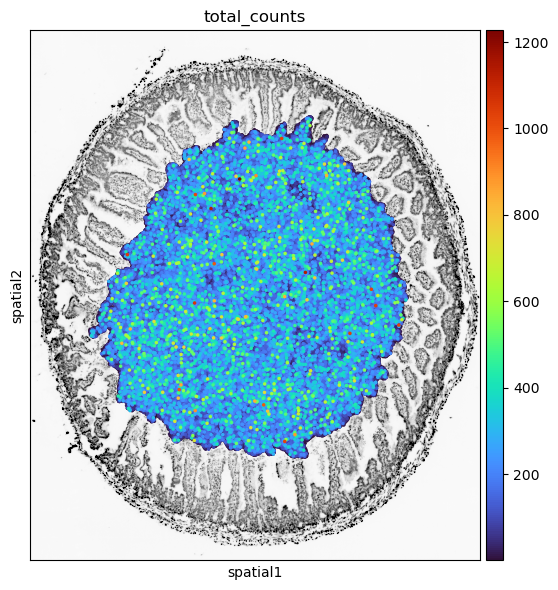

In [184]:
fig, ax = plt.subplots(figsize=(6,6))

ax.imshow(ref_img, vmax=50, cmap = 'Greys')

target = 'total_counts'


sc.pl.embedding(adata_func[adata_func.obs['mask_tissue']], 
                basis="spatial", 
                use_raw=False, 
                size=20, 
                scale_factor=1.0, 
                color=target, 
                cmap='turbo', 
                #vmax = 300,
                ax=ax, 
                show=False)
plt.xlim(3650,8750)
plt.ylim(1900,7900)
plt.tight_layout()

In [ ]:
# mask by 

# Overlap with microscope image

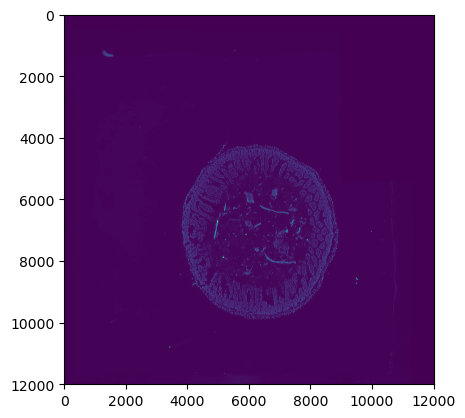

In [176]:
# microscopy image greyscale

ref_img = cv.imread('/workdir/lt425/202402_stereoseq/D611/SAW/result_20240410/03.register/ssDNA_C02927D611_regist.tif', cv.IMREAD_GRAYSCALE)

plt.imshow(ref_img, extent=[0, 12000, 0, 12000])
plt.gca().invert_yaxis()  # y軸の向きを入れ替える
#plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


(1900.0, 7900.0)

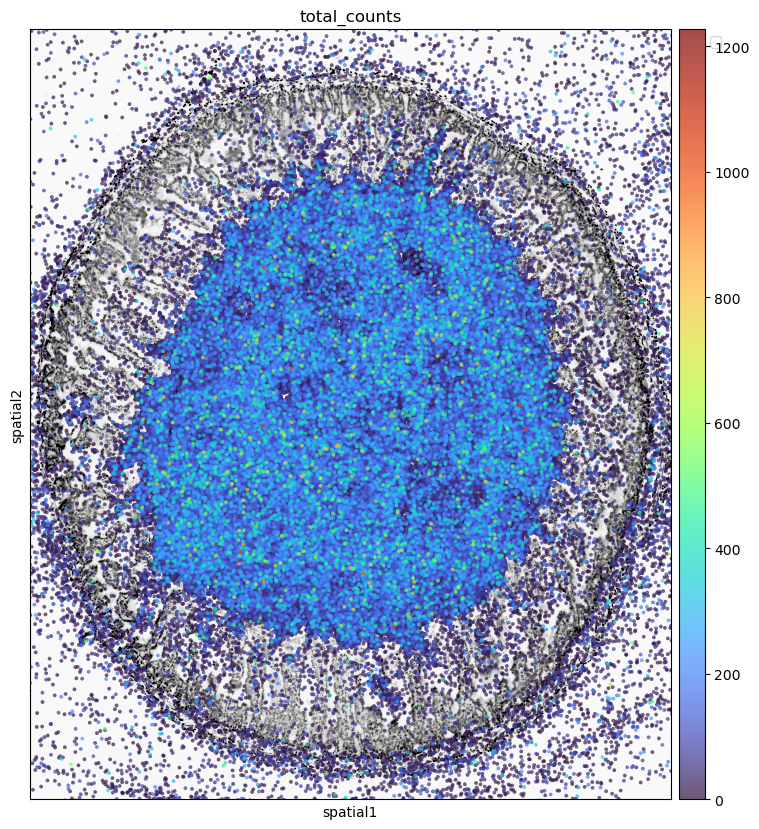

In [177]:
import copy
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
import pandas as pd

thre_read_spots = 5

fig, ax = plt.subplots(figsize=(10,10))

########
# microscope
########
plt.imshow(ref_img, vmax=50, cmap = 'Greys')


########
# host
########


adata = adata_func[adata_func.obs['total_counts']>thre_read_spots]

adata_host_temp = pd.Series(['Others'] * len(adata.obs), index = adata.obs.index)

sc.pl.embedding(
    adata, 
    basis="spatial", 
    use_raw=False,
    color=['total_counts'],  # 'cell2loc_selected' の値に応じて色を設定
    cmap='turbo',  # カラーマップを指定
    na_color='grey',
    vmin=0,
    show=False,
    alpha=0.7,
    size=30,
    ax=ax
)

ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xlim(3700,8700)
plt.ylim(1900,7900)
#plt.show()

#plt.savefig('/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/host-microbe-integrated/host.tiff', format='tiff')

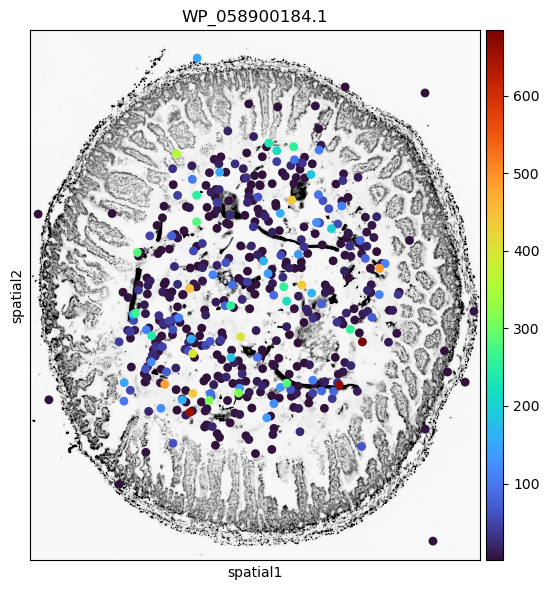

In [186]:
fig, ax = plt.subplots(figsize=(6,6))

ax.imshow(ref_img, vmax=50, cmap = 'Greys')

target = 'WP_058900184.1'
target_idx = adata_func.var_names.get_loc(target)
mask = adata_func.X[:, target_idx] > 0

sc.pl.embedding(adata_func[mask], 
                basis="spatial", 
                use_raw=False, 
                size=50, 
                scale_factor=1.0, 
                color=target, 
                cmap='turbo', 
                #vmax = 300,
                ax=ax, 
                show=False)
plt.xlim(3650,8750)
plt.ylim(1900,7900)
plt.tight_layout()

/tmp/ipykernel_3616185/3679575358.py:11: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['total_temp'] = adata.X.sum(axis=1)


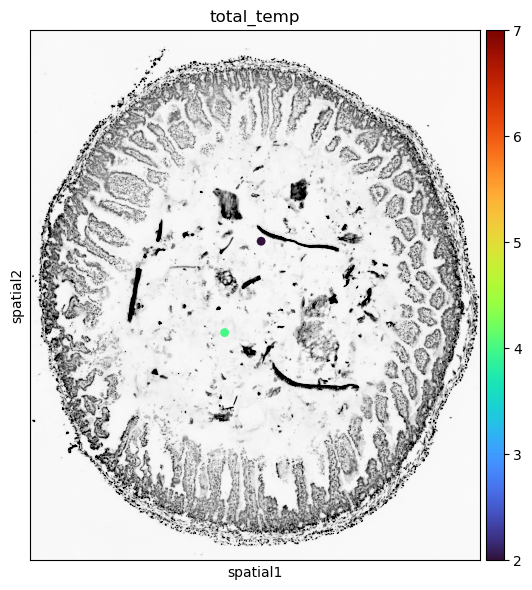

In [228]:
fig, ax = plt.subplots(figsize=(6,6))

ax.imshow(ref_img, vmax=50, cmap = 'Greys')

target = 'NODE_388_length_4491_cov_27.688683_'
#target_idx = adata_func.var_names.get_loc(target)#[i for i, var_name in enumerate(adata_func.var_names) if target in var_name]#
#mask = adata_func.X[:, target_idx] > 0
target_indices = [i for i, var_name in enumerate(adata_func.var_names) if target in var_name]
mask = adata_func[:, target_indices].X.sum(axis=1)>0#adata_func.X[:, target_indices] > 0
adata = adata_func[:, target_indices][mask]
adata.obs['total_temp'] = adata.X.sum(axis=1)

sc.pl.embedding(adata, 
                basis="spatial", 
                use_raw=False, 
                size=50, 
                scale_factor=1.0, 
                color='total_temp', 
                cmap='turbo', 
                #vmax = 300,
                ax=ax, 
                show=False)
plt.xlim(3650,8750)
plt.ylim(1900,7900)
plt.tight_layout()

In [200]:
adata_func[mask].to_df()

features,NODE_10815_length_819_cov_4.040576_1,WP_010998475.1,NODE_304216_length_165_cov_7.227273_1,NODE_299838_length_203_cov_3.378378_1,NODE_300970_length_192_cov_2.204380_1,NODE_313474_length_121_cov_0.621212_1,NODE_330857_length_89_cov_2.294118_1,NODE_7457_length_969_cov_4.045952_1,NODE_388_length_4491_cov_27.688683_2,NODE_321359_length_105_cov_7.380000_1,...,NODE_223164_length_227_cov_0.994186_1,NODE_304048_length_167_cov_1.464286_1,NODE_335478_length_75_cov_7.650000_1,NODE_276879_length_211_cov_0.801282_1,NODE_5400_length_1131_cov_2.729554_2,NODE_315307_length_115_cov_4.266667_1,NODE_260184_length_215_cov_1.737500_1,NODE_319891_length_107_cov_46.134615_1,NODE_15259_length_697_cov_2.789720_1,NODE_329010_length_96_cov_1.878049_1
barcodes,,,,,,,,,,,,,,,,,,,,,
GGAGCTACCTGTACGAAGCTAAACG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
CGCAGAAGAGTAGAGACACGTGGAG,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [224]:
adata_func[:, target_indices][adata_func[:, target_indices].X.sum(axis=1)>0]

View of AnnData object with n_obs × n_vars = 4 × 3
    obs: 'barcodes', 'total_counts', 'mask_tissue'
    var: 'cog', 'gen', 'cat1', 'cat2', 'gen2', 'cat3', 'bac', 'total'
    uns: 'spatial'
    obsm: 'spatial'

In [226]:
adata_func[:, target_indices][adata_func[:, target_indices].X.sum(axis=1)>0].to_df()

features,NODE_388_length_4491_cov_27.688683_2,NODE_388_length_4491_cov_27.688683_3,NODE_388_length_4491_cov_27.688683_1
barcodes,,,
TTTCACGCAACCTCACTTAGCACCG,0.0,0.0,7.0
GTAGTAGGACGTGTTTGTCACGGTT,4.0,0.0,0.0
GGAGCTACCTGTACGAAGCTAAACG,0.0,2.0,0.0
CGCAGAAGAGTAGAGACACGTGGAG,0.0,3.0,0.0


In [227]:
adata_func[:, target_indices][adata_func[:, target_indices].X.sum(axis=1)>0].obs

,barcodes,total_counts,mask_tissue
barcodes,,,
TTTCACGCAACCTCACTTAGCACCG,TTTCACGCAACCTCACTTAGCACCG,16.0,False
GTAGTAGGACGTGTTTGTCACGGTT,GTAGTAGGACGTGTTTGTCACGGTT,4.0,True
GGAGCTACCTGTACGAAGCTAAACG,GGAGCTACCTGTACGAAGCTAAACG,2.0,True
CGCAGAAGAGTAGAGACACGTGGAG,CGCAGAAGAGTAGAGACACGTGGAG,3.0,False


In [46]:
import scanpy as sc
adata_bac = sc.read('/workdir/lt425/202402_stereoseq/nontotal/D611_analysis/adata_Bacteria.h5ad')
adata_bac

/home/lt425/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/scipy/__init__.py:155: UserWarning: A NumPy version >=1.18.5 and <1.25.0 is required for this version of SciPy (detected version 1.26.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"
/home/lt425/miniconda3/envs/cell2loc_env/lib/python3.9/site-packages/anndata/_core/anndata.py:183: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 6684813 × 5504
    obs: 'barcodes', 'x_coordinate', 'y_coordinate', 'total_counts'
    var: 'features', 'superkingdom', 'phylum', 'family', 'genus', 'species'
    uns: 'spatial'
    obsm: 'spatial'

In [62]:
import pandas as pd
import numpy as np
temp_func = pd.Series(index = adata_bac.obs.index)

for i in umi_function.keys():
    if i != '-':
        COG = umi_function[i][1]
        gcf = umi_function[i][2]
        category = umi_function[i][3]
        gene_long = umi_function[i][4]
        gene_short = umi_function[i][5]
        cat_long = umi_function[i][6]
        tax = umi_function[i][-2]
        spat_bcd = umi_function[i][-1]
        if spat_bcd in temp_func.index:
            if np.isnan(temp_func[spat_bcd]):
                temp_func[spat_bcd] = category
            else:
                print (spat_bcd)

temp_func

/tmp/ipykernel_2292015/3308064622.py:17: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value 'J' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  temp_func[spat_bcd] = category


barcodes
GCTGATCCCCGTTTGACCACCCTAC    NaN
GGGTATAGCTACGAGTTCTGGATAC    NaN
TGCTAATCGCCCGAGAGGTTTGTCC    NaN
AATCCAGGCGTGCTTGGTCGTGAAT    NaN
GGACCGATGAGTGTTTTATCAGTTT    NaN
                            ... 
AGCAGGTTACCTATCAGATGATCCC    NaN
TGTAACTGCTCCGTCAGACACCTTC    NaN
CGCAATTCCGTATTTCTACGTCATG    NaN
CTACCAAAGTCAAATGGACTTACCG    NaN
AGATTGCGATTTCCCAGCGTGTAAT    NaN
Length: 6684813, dtype: object

In [64]:
temp_func[spat_bcd]

'J'

In [65]:
spat_bcd

'GTCAGCGAGACCTCGGAGCCCATGG'

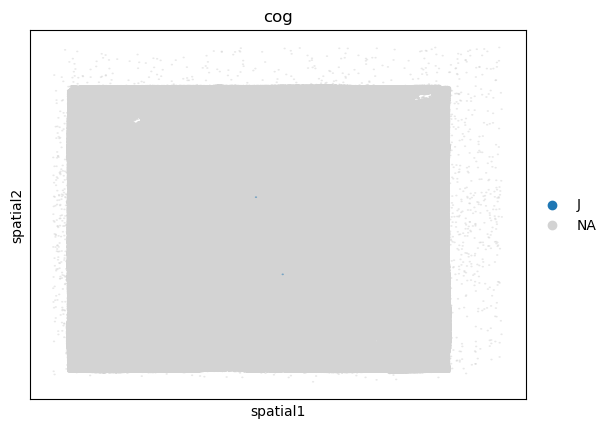

In [67]:
adata_bac.obs['cog'] = temp_func

sc.pl.embedding(
    adata_bac , 
    basis="spatial", 
    use_raw=False,
    color=['cog'],  # 'cell2loc_selected' の値に応じて色を設定
    #cmap=cmap_custom,  # カラーマップを指定
    #na_color='grey',
    vmin=0,
    scale_factor=1.0, 
    alpha=0.5,
    size=30,
)